## Real-time selective sequencing using nanopore technology. Figures and Analysis

### Introduction

This jupyter notebook requires the R kernel. 

Each figure from the manuscript "Real-time seletive sequencing using nanopore technology" is reproduced in this notebook. Figures are presented by panel and in the order in which they are considered in the manuscript.

In [1]:
library(ggplot2)
library("gridExtra")
library("plyr")

### Figure 1A
A simulated reference squiggle.

In [2]:
##Generate Perfect Model Off Reference
lambdaref=read.csv("data/fig1/Lambda_100BP.csv", header = TRUE)

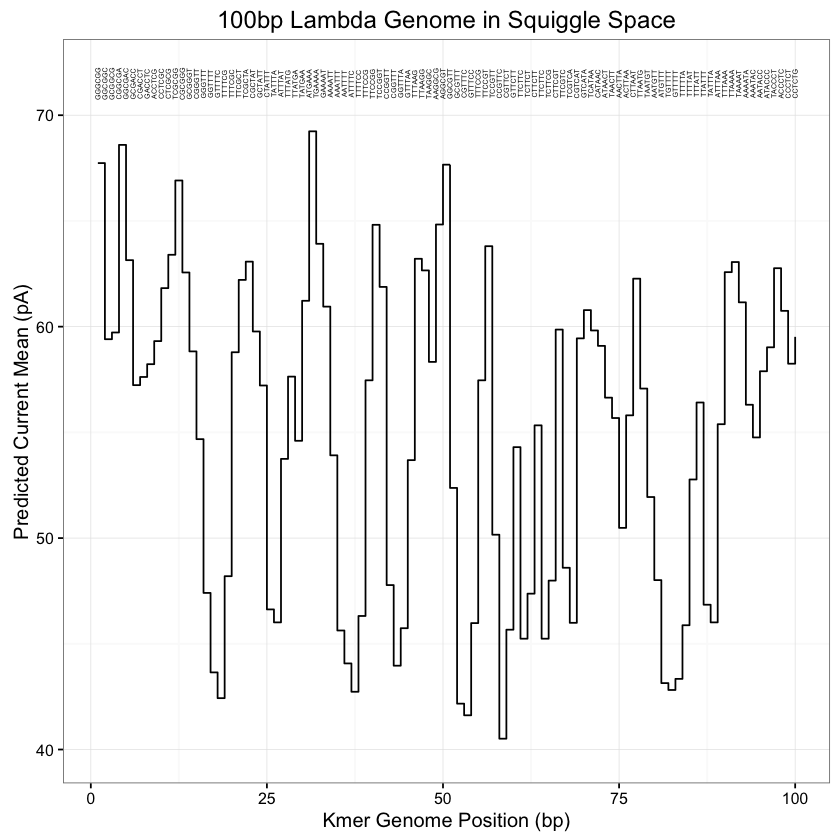

In [3]:
ggplot(data=lambdaref,aes(x=Position, y=Mean))+geom_step() + geom_text(aes(x=Position, y=71.5,label=Kmer), color='black',srt=90, size= 1.5) + theme_bw() + labs(title = "100bp Lambda Genome in Squiggle Space",x = "Kmer Genome Position (bp)", y = "Predicted Current Mean (pA)") + ylim(40,72) + xlim(1, 100)

This figure shows the first 100bp of bacteriophage lambda in squiggle space. Individual kmers are shown above each event in the squiggle.

### Figure S1

Individual reads derived from a reference are subject to shift, scale and drift variance. Here we simulate the effects of shift, scale and drift on a read.


In [4]:
datlambda1 = read.csv("data/figS1/lambda1.csv", header = TRUE)


###Shifted Data - shift the mean by +20 pA

shiftdata = datlambda1[50:200,]
shiftdata$Mean <- (shiftdata$Mean+20)



###Scaled Data - apply an extreme rescaling for illustrative purposes
scaledata = datlambda1[50:200,]
rescale <- function(x) (x-min(x))/(max(x) - min(x)) * 100
scaledata$Mean <- rescale(scaledata$Mean)



###Drift Data - apply extreme drift of 10 pA over 150 events for illustrative purposes
driftdata = datlambda1[50:200,]
driftdata$Count <- seq(from=0, to=150, by=1)
driftdata$Mean <- driftdata$Mean + (driftdata$Count/50)*10



Now we investigate the consequences of normalising each of these data sets using a simple Z-score.

In [5]:
###Z Score Normalising

#Normalise the original read.

znormdata = datlambda1[50:200,]
znormdata$Mean <- (znormdata$Mean - mean(znormdata$Mean))/sd(znormdata$Mean)

#Normalise the shifted read
znormshift = shiftdata
znormshift$Mean <- (znormshift$Mean - mean(znormshift$Mean))/sd(znormshift$Mean)

#Normalise the scaled read
znormscale = scaledata
znormscale$Mean <- (znormscale$Mean - mean(znormscale$Mean))/sd(znormscale$Mean)

#Normalise the drift read
znormdrift = driftdata
znormdrift$Mean <- (znormdrift$Mean - mean(znormdrift$Mean))/sd(znormdrift$Mean)


Now we plot the 8 datasets:

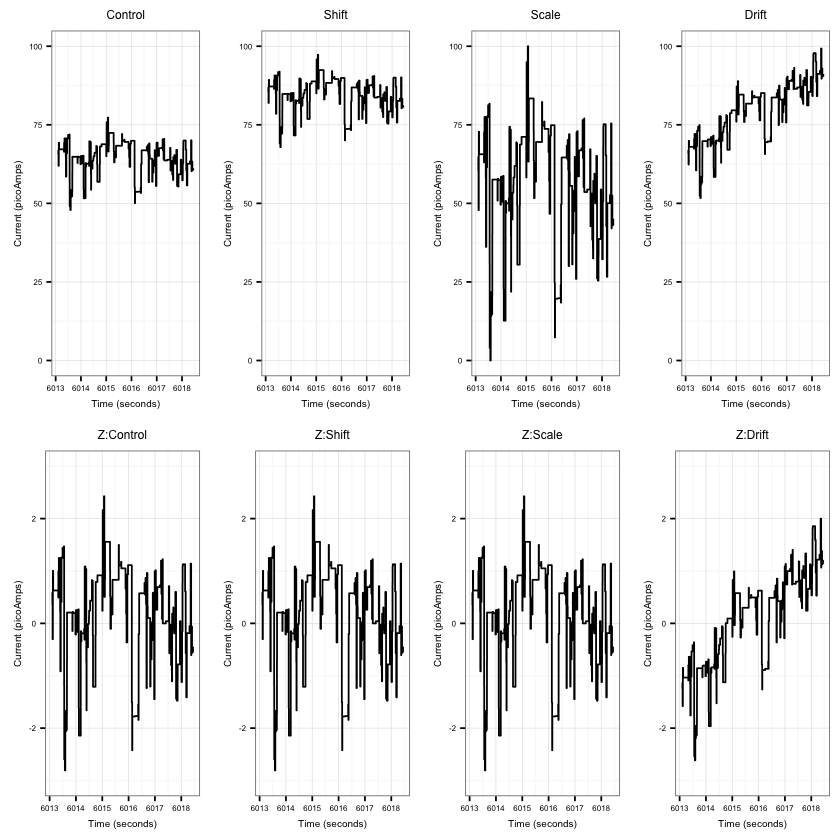

In [6]:
S1A<-ggplot(data=datlambda1[50:200,], aes(x=Time, y=Mean) )+geom_step()+labs(title = "Control",x = "Time (seconds)")+labs(y="Current (picoAmps)") + theme_bw() + theme(text = element_text(size=6)) + ylim(0,100)
S1B<-ggplot(data=shiftdata, aes(x=Time, y=Mean) )+geom_step()+labs(title = "Shift",x = "Time (seconds)")+labs(y="Current (picoAmps)") + theme_bw() + theme(text = element_text(size=6))+ ylim(0,100)
S1C<-ggplot(data=scaledata, aes(x=Time, y=Mean) )+geom_step()+labs(title = "Scale",x = "Time (seconds)")+labs(y="Current (picoAmps)") + theme_bw() + theme(text = element_text(size=6))+ ylim(0,100)
S1D<-ggplot(data=driftdata, aes(x=Time, y=Mean) )+geom_step()+labs(title = "Drift",x = "Time (seconds)")+labs(y="Current (picoAmps)") + theme_bw() + theme(text = element_text(size=6))+ ylim(0,100)
S1E<-ggplot(data=znormdata, aes(x=Time, y=Mean) )+geom_step()+labs(title = "Z:Control",x = "Time (seconds)")+labs(y="Current (picoAmps)")+ theme_bw() + theme(text = element_text(size=6))+ ylim(-3,3)
S1F<-ggplot(data=znormshift, aes(x=Time, y=Mean) )+geom_step()+labs(title = "Z:Shift",x = "Time (seconds)")+labs(y="Current (picoAmps)")+ theme_bw() + theme(text = element_text(size=6))+ ylim(-3,3)
S1G<-ggplot(data=znormscale, aes(x=Time, y=Mean) )+geom_step()+labs(title = "Z:Scale",x = "Time (seconds)")+labs(y="Current (picoAmps)")+ theme_bw() + theme(text = element_text(size=6))+ ylim(-3,3)
S1H<-ggplot(data=znormdrift, aes(x=Time, y=Mean) )+geom_step()+labs(title = "Z:Drift",x = "Time (seconds)")+labs(y="Current (picoAmps)")+ theme_bw() + theme(text = element_text(size=6))+ ylim(-3,3)
grid.arrange(S1A, S1B, S1C, S1D,S1E,S1F,S1G,S1H, nrow=2,ncol=4)

### Figure 1 B,C

Next we consider the impact of in/dels with respect to events on real reads in nanopore data. This is the motivation for considering Dynamic Time Warping for mapping reads to reference.

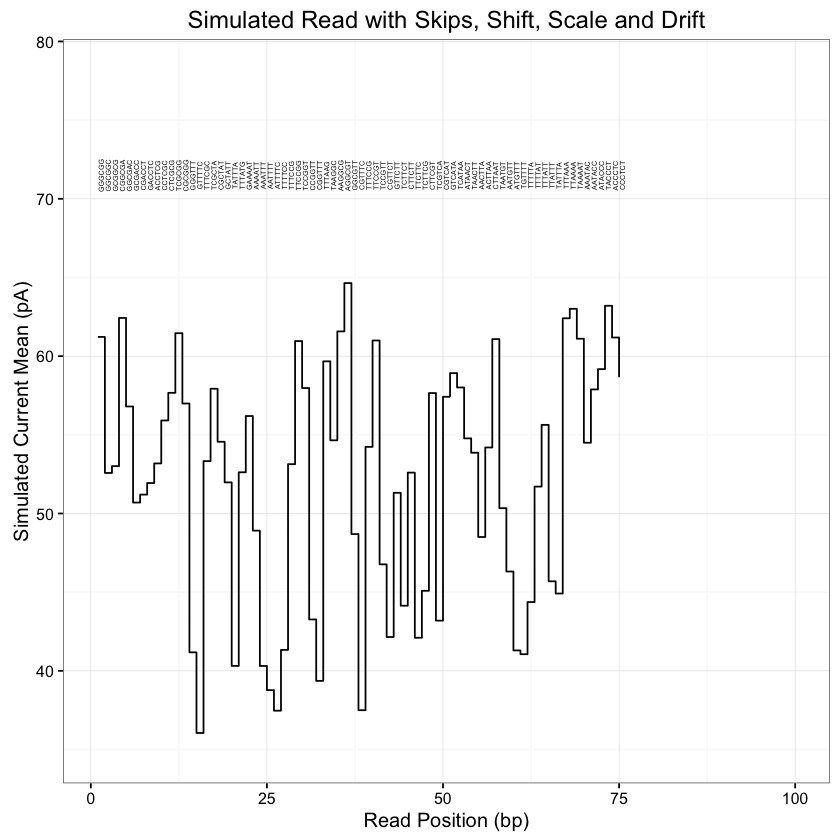

In [7]:
##Simulate skipped events by deleting 25 random rows from data set
lambdadel = lambdaref[-sample(1:nrow(lambdaref), 25), ]
##Generate Corrected Positions for the new read
z<- seq(1, length.out=nrow(lambdadel), by=1)
lambdadel <- cbind(CorrectedPos=z,lambdadel)
ggplot(data=lambdadel,aes(x=CorrectedPos, y=((Mean*1.05)+(0.1*CorrectedPos))-10))+geom_step() + geom_text(aes(x=CorrectedPos+0.5, y=71.5,label=Kmer), color='black',srt=90, size= 1.5) + theme_bw() + labs(title = "Simulated Read with Skips, Shift, Scale and Drift",x = "Read Position (bp)", y = "Simulated Current Mean (pA)") + xlim(1, 100) + ylim(35,78)

#### Figure 1B - showing the effective truncation of a read with skips (i.e deleted events)

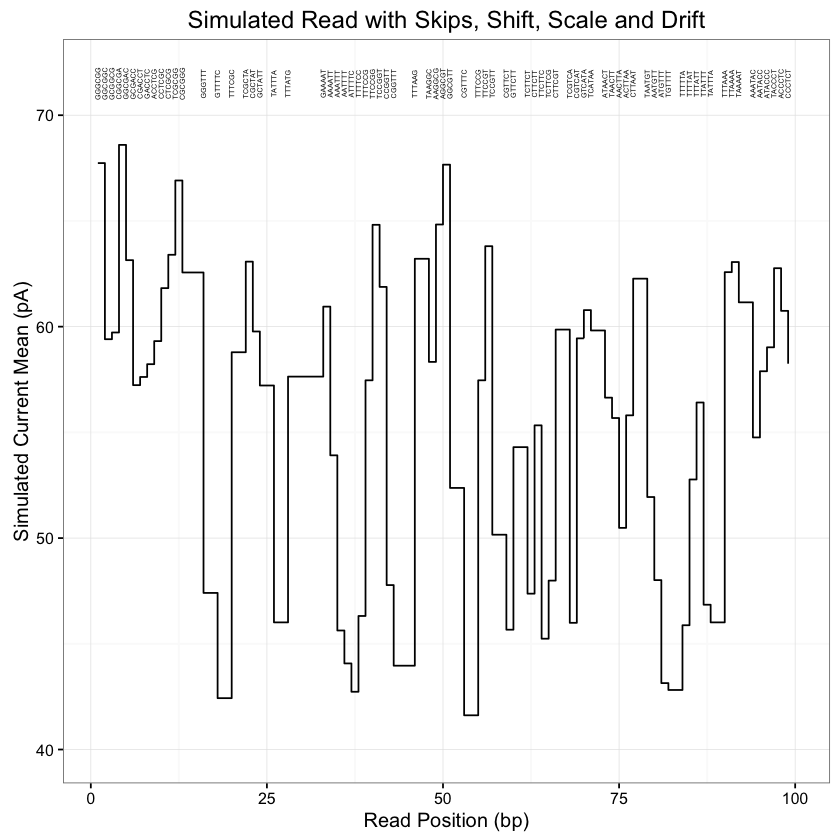

In [8]:
ggplot(data=lambdadel,aes(x=Position, y=Mean))+geom_step() + geom_text(aes(x=Position, y=71.5,label=Kmer), color='black',srt=90, size= 1.5) + theme_bw() + labs(title = "Simulated Read with Skips, Shift, Scale and Drift",x = "Read Position (bp)", y = "Simulated Current Mean (pA)") + xlim(1, 100) + ylim(40,72)


#### Figure 1C showing the same read as 1B corrected for skips.

### Figure S2 - Investigating the ability of DTW to place reads with respect to a reference.

In [9]:
fname = 'data/figs2/out.txt'

par(mfrow=c(4,2))

#summary(a)
titles =   c( 'Lambda Synthetic Reads' , 'Lambda Amp3 Reads RU21' )

normText = c("Un-normalised", "Normalised")

letters = c("A", "B", "C", "D", "E", "F", "G", "H")

a<-read.table(file=fname, sep=',', header=F)


colnames(a) <- c(
"ReadFolder", "Normalise", "Chapter", "File", "Amplicon"
        , "winSz", "Len", "qrySz", "Offset"
        , "Read", "Ref", "Time_t", "trg", "Pos", "outBy", "read_t_Success"
        , "Read_", "Ref_", "Time_c", "trg_", "Pos_", "outBy", "read_c_Success_"
        , "dim", "quasi2d"
        )

a$Time <- a$Time_t + a$Time_c
a$ReadFolder <- factor(a$ReadFolder)
a$Normalise <- factor(a$Normalise)
folders = rev(levels(a$ReadFolder))
normalisations = levels(a$Normalise)
j=1
for (n in normalisations) {
for (f in folders) {


folderNum = which(folders == f)
normNum = which(normalisations == n)
b <- a[ a$ReadFolder == f & a$Normalise == n & a$read_t_Success==' True', ]

#print(f)

if (f=="synthetic") numReads=100 else numReads=48
#print(numReads)

#attach(b)
#summary(b)
x0 <- xtabs(~winSz+Read+Ref+winSz)
#print(x0)




ftable(x0, col.vars=c(2,3))


xc <- xtabs(~winSz) 
#print(xc)

xt <- xtabs(Time~winSz)
#print(xt)
m <- as.matrix(t(xc))/numReads*100
#print(m)
txt <- paste( letters[j], ") ", titles[folderNum], ", ", normText[normNum], sep="" )
#print(txt)
barplot(m, ylim=c(0,110), col='grey',ylab='Aligned Reads (%)', xlab='Window Size', main=txt)
grid()
j=j+1

m <- as.matrix(t(xt))
#barplot(m, plot=F)
#txt <- paste( letters[j], titles[folderNum], normText[normNum], sep=": " )
txt <- paste( letters[j], ") ", titles[folderNum], ", ", normText[normNum], sep="" )
#print(txt)
barplot(m, col='grey',ylab='Time (seconds)', xlab='Window Size', main=txt)
grid()
j=j+1

}}

ERROR: Error in eval(expr, envir, enclos): object 'winSz' not found


## Selective Enrichment of Targeted Regions of the Lambda Genome

### Figure 2A - 30b/s enrichment over the lambda genome.

Here we show enrichment over two 5 kb regions (10-15 kb and 30-35 kb) sequencing with SQK5 chemistry (30 b/s) and applying read until only to the even numbered channels.


In [10]:
system("genomeCoverageBed -ibam data/fig2/RU7/ALL/ALL_RU7_2D.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/ALL/ALL_RU7_2D.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU7/ALL/ALL_RU7_Complement.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/ALL/ALL_RU7_Complement.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU7/ALL/ALL_RU7_Template.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/ALL/ALL_RU7_Template.txt",intern=FALSE)

system("genomeCoverageBed -ibam data/fig2/RU7/EVEN/EVEN_RU7_2D.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/EVEN/EVEN_RU7_2D.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU7/EVEN/EVEN_RU7_Complement.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/EVEN/EVEN_RU7_Complement.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU7/EVEN/EVEN_RU7_Template.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/EVEN/EVEN_RU7_Template.txt",intern=FALSE)

system("genomeCoverageBed -ibam data/fig2/RU7/ODD/ODD_RU7_2D.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/ODD/ODD_RU7_2D.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU7/ODD/ODD_RU7_Complement.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/ODD/ODD_RU7_Complement.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU7/ODD/ODD_RU7_Template.bam -g data/fig2/lambda.genome -d > data/fig2/RU7/ODD/ODD_RU7_Template.txt",intern=FALSE)

In [11]:
EVEN_RU7_Template = read.csv("data/fig2/RU7/EVEN/EVEN_RU7_Template.txt", header = FALSE,sep="\t")
EVEN_RU7_Complement = read.csv("data/fig2/RU7/EVEN/EVEN_RU7_Complement.txt", header = FALSE,sep="\t")
EVEN_RU7_2D = read.csv("data/fig2/RU7/EVEN/EVEN_RU7_2D.txt", header = FALSE,sep="\t")

ODD_RU7_Template = read.csv("data/fig2/RU7/ODD/ODD_RU7_Template.txt", header = FALSE,sep="\t")
ODD_RU7_Complement = read.csv("data/fig2/RU7/ODD/ODD_RU7_Complement.txt", header = FALSE,sep="\t")
ODD_RU7_2D = read.csv("data/fig2/RU7/ODD/ODD_RU7_2D.txt", header = FALSE,sep="\t")

ALL_RU7_Template = read.csv("data/fig2/RU7/ALL/ALL_RU7_Template.txt", header = FALSE,sep="\t")
ALL_RU7_Complement = read.csv("data/fig2/RU7/ALL/ALL_RU7_Complement.txt", header = FALSE,sep="\t")
ALL_RU7_2D = read.csv("data/fig2/RU7/ALL/ALL_RU7_2D.txt", header = FALSE,sep="\t")


RU7<-cbind(EVEN_RU7_Template,EVEN_RU7_Complement$V3,EVEN_RU7_2D$V3,ODD_RU7_Template$V3,ODD_RU7_Complement$V3,ODD_RU7_2D$V3,ALL_RU7_Template$V3,ALL_RU7_Complement$V3,ALL_RU7_2D$V3)
colnames(RU7) <- c("Ref", "Position","E_Template","E_Complement","E_2D","O_Template","O_Complement","O_2D","A_Template","A_Complement","A_2D")


## We import a file containing the read lengths for 2D sequences in this library:
RU7_lengths = read.csv("data/fig2/RU7/ALL/2Dlengths.txt",header = FALSE,sep="\t")
RU7_lengths <- cbind(RU7_lengths,type="2D")


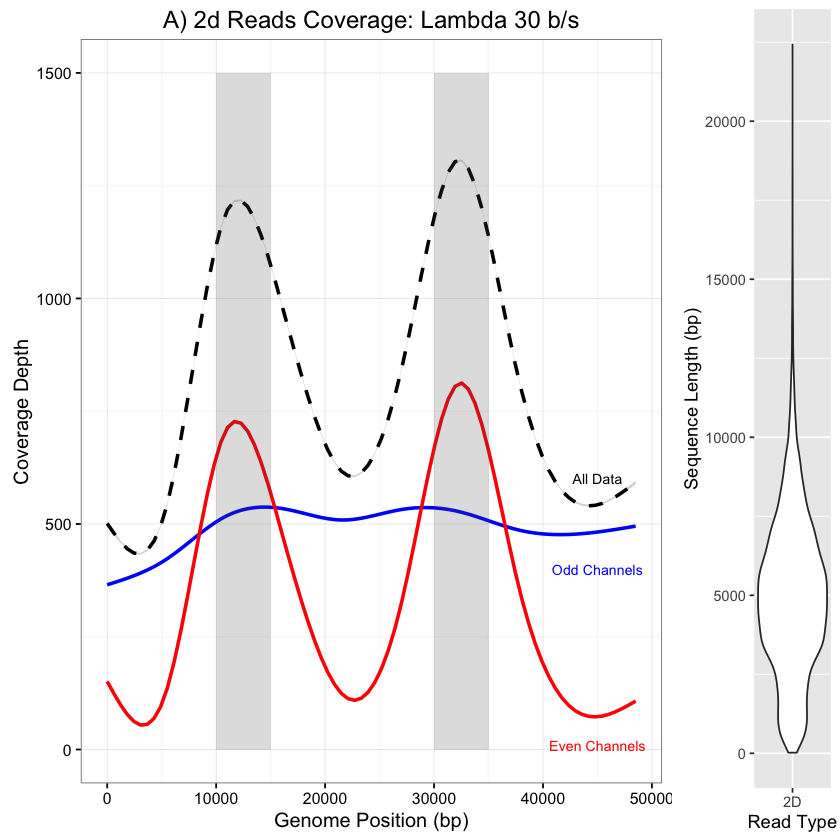

In [12]:
Fig2Ai<-ggplot(data=RU7,aes(x=Position,y=E_2D)) + theme_bw() +geom_smooth(aes(x=Position,y=O_2D),size = 1, color="blue")+geom_smooth(aes(x=Position,y=E_2D),size = 1, color="red") + geom_smooth(aes(x=Position,y=A_2D),size = 1, color="black",linetype="dashed") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "A) 2d Reads Coverage: Lambda 30 b/s") + annotate("text", x = 45000, y = 10, label = "Even Channels", color = "red",size=3)+ annotate("text", x = 45000, y = 400, label = "Odd Channels", color = "blue",size=3) + annotate("text", x = 45000, y = 600, label = "All Data", color = "Black",size=3) + annotate("rect", xmin = 10000, xmax = 15000,ymin=0,ymax=1500,alpha = .2) + annotate("rect", xmin = 30000, xmax = 35000,ymin=0,ymax=1500,alpha = .2)
Fig2Aii<-ggplot(data=RU7_lengths,aes(x=type,y=V1))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")
grid.arrange(Fig2Ai,Fig2Aii,       ncol=2, nrow=1, widths=c(16, 4))

### Figure 2B - 70b/s enrichment over the lambda genome.

Here we show enrichment over two 5 kb regions (10-15 kb and 35-40 kb) sequencing with SQK6 chemistry (70 b/s) and applying read until only to the even numbered channels.



In [13]:
system("genomeCoverageBed -ibam data/fig2/RU9/ALL/ALL_RU9_2D.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/ALL/ALL_RU9_2D.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU9/ALL/ALL_RU9_Complement.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/ALL/ALL_RU9_Complement.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU9/ALL/ALL_RU9_Template.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/ALL/ALL_RU9_Template.txt",intern=FALSE)

system("genomeCoverageBed -ibam data/fig2/RU9/EVEN/EVEN_RU9_2D.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/EVEN/EVEN_RU9_2D.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU9/EVEN/EVEN_RU9_Complement.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/EVEN/EVEN_RU9_Complement.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU9/EVEN/EVEN_RU9_Template.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/EVEN/EVEN_RU9_Template.txt",intern=FALSE)

system("genomeCoverageBed -ibam data/fig2/RU9/ODD/ODD_RU9_2D.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/ODD/ODD_RU9_2D.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU9/ODD/ODD_RU9_Complement.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/ODD/ODD_RU9_Complement.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU9/ODD/ODD_RU9_Template.bam -g data/fig2/lambda.genome -d > data/fig2/RU9/ODD/ODD_RU9_Template.txt",intern=FALSE)

In [14]:
EVEN_RU9_Template = read.csv("data/fig2/RU9/EVEN/EVEN_RU9_Template.txt", header = FALSE,sep="\t")
EVEN_RU9_Complement = read.csv("data/fig2/RU9/EVEN/EVEN_RU9_Complement.txt", header = FALSE,sep="\t")
EVEN_RU9_2D = read.csv("data/fig2/RU9/EVEN/EVEN_RU9_2D.txt", header = FALSE,sep="\t")

ODD_RU9_Template = read.csv("data/fig2/RU9/ODD/ODD_RU9_Template.txt", header = FALSE,sep="\t")
ODD_RU9_Complement = read.csv("data/fig2/RU9/ODD/ODD_RU9_Complement.txt", header = FALSE,sep="\t")
ODD_RU9_2D = read.csv("data/fig2/RU9/ODD/ODD_RU9_2D.txt", header = FALSE,sep="\t")

ALL_RU9_Template = read.csv("data/fig2/RU9/ALL/ALL_RU9_Template.txt", header = FALSE,sep="\t")
ALL_RU9_Complement = read.csv("data/fig2/RU9/ALL/ALL_RU9_Complement.txt", header = FALSE,sep="\t")
ALL_RU9_2D = read.csv("data/fig2/RU9/ALL/ALL_RU9_2D.txt", header = FALSE,sep="\t")


RU9<-cbind(EVEN_RU9_Template,EVEN_RU9_Complement$V3,EVEN_RU9_2D$V3,ODD_RU9_Template$V3,ODD_RU9_Complement$V3,ODD_RU9_2D$V3,ALL_RU9_Template$V3,ALL_RU9_Complement$V3,ALL_RU9_2D$V3)
colnames(RU9) <- c("Ref", "Position","E_Template","E_Complement","E_2D","O_Template","O_Complement","O_2D","A_Template","A_Complement","A_2D")


## We import a file containing the read lengths for 2D sequences in this library:
RU9_lengths = read.csv("data/fig2/RU9/ALL/2Dlengths.txt",header = FALSE,sep="\t")
RU9_lengths <- cbind(RU9_lengths,type="2D")

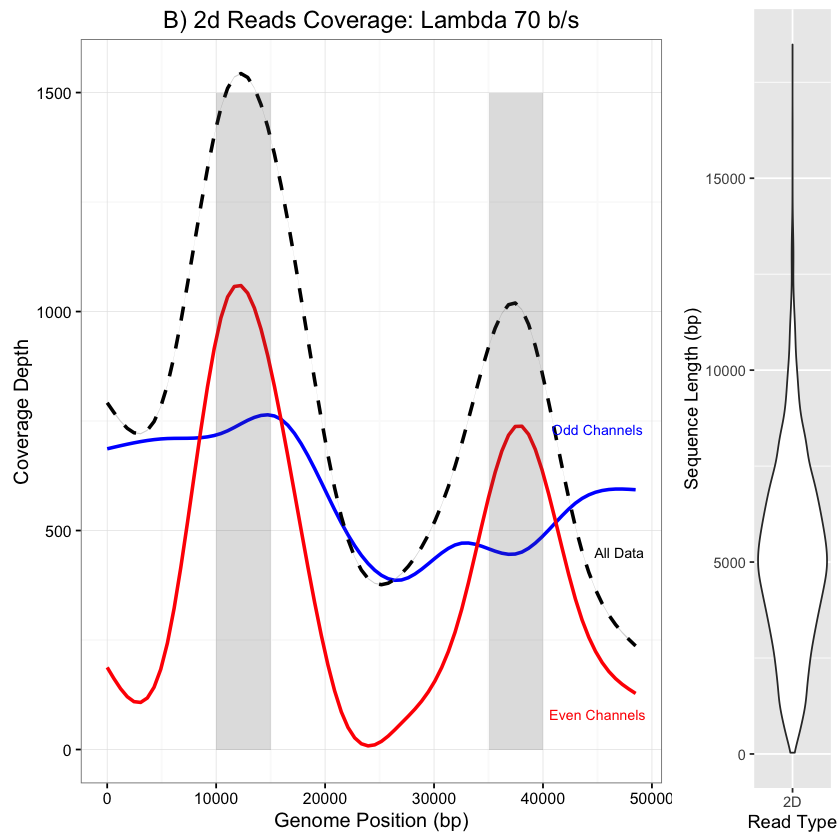

In [15]:
Fig2Bi<-ggplot(data=RU9,aes(x=Position,y=E_2D)) + theme_bw() +geom_smooth(aes(x=Position,y=O_2D),size = 1, color="blue")+geom_smooth(aes(x=Position,y=E_2D),size = 1, color="red") + geom_smooth(aes(x=Position,y=A_2D),size = 1, color="black",linetype="dashed") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "B) 2d Reads Coverage: Lambda 70 b/s") + annotate("text", x = 45000, y = 80, label = "Even Channels", color = "red",size=3)+ annotate("text", x = 45000, y = 730, label = "Odd Channels", color = "blue",size=3) + annotate("text", x = 47000, y = 450, label = "All Data", color = "Black",size=3) + annotate("rect", xmin = 10000, xmax = 15000,ymin=0,ymax=1500,alpha = .2) + annotate("rect", xmin = 35000, xmax = 40000,ymin=0,ymax=1500,alpha = .2)
Fig2Bii<-ggplot(data=RU9_lengths,aes(x=type,y=V1))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")
grid.arrange(Fig2Bi,Fig2Bii,       ncol=2, nrow=1, widths=c(16, 4))

### Figure 2C - 70b/s enrichment over the lambda genome - single peak.

Here we show enrichment over one 10 kb regions (15-25 kb) sequencing with SQK6 chemistry (70 b/s) and applying read until to all the channels.


In [16]:
system("genomeCoverageBed -ibam data/fig2/RU11/ALL/ALL_RU9_2D.bam -g data/fig2/lambda.genome -d > data/fig2/RU11/ALL/ALL_RU11_2D.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU11/ALL/ALL_RU9_Complement.bam -g data/fig2/lambda.genome -d > data/fig2/RU11/ALL/ALL_RU11_Complement.txt",intern=FALSE)
system("genomeCoverageBed -ibam data/fig2/RU11/ALL/ALL_RU9_Template.bam -g data/fig2/lambda.genome -d > data/fig2/RU11/ALL/ALL_RU11_Template.txt",intern=FALSE)

In [17]:
ALL_RU11_Template = read.csv("data/fig2/RU11/ALL_RU11_Template.txt", header = FALSE,sep="\t")
ALL_RU11_Complement = read.csv("data/fig2/RU11/ALL_RU11_Complement.txt", header = FALSE,sep="\t")
ALL_RU11_2D = read.csv("data/fig2/RU11/ALL_RU11_2D.txt", header = FALSE,sep="\t")

RU11<-cbind(ALL_RU11_Template,ALL_RU11_Complement$V3,ALL_RU11_2D$V3)
colnames(RU11) <- c("Ref", "Position","Template","Complement","R2D")
RU11_lengths = read.csv("data/fig2/RU11/2Dlengths.txt",header = FALSE,sep="\t")
RU11_lengths <- cbind(RU11_lengths,type="2D")

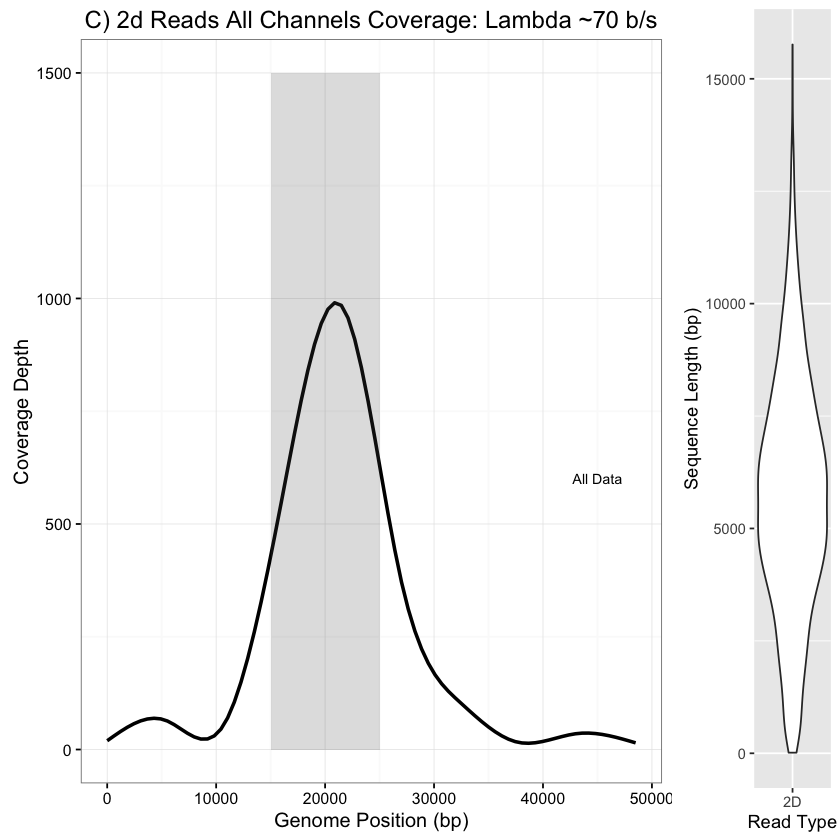

In [18]:
Fig2Ci<-ggplot(data=RU11,aes(x=Position,y=R2D)) + theme_bw() +geom_smooth(aes(x=Position,y=R2D),size = 1, color="black") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "C) 2d Reads All Channels Coverage: Lambda ~70 b/s")  + annotate("rect", xmin = 15000, xmax = 25000,ymin=0,ymax=1500,alpha = .2)+ annotate("text", x = 45000, y = 600, label = "All Data", color = "Black",size=3)
Fig2Cii<-ggplot(data=RU11_lengths,aes(x=type,y=V1))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")
grid.arrange(Fig2Ci,Fig2Cii,       ncol=2, nrow=1, widths=c(16, 4))

### Figure 3 - Selective Sequencing of Amplicons

In [19]:
##First collect the data from the BAM files to process.
NO_RU_2D = read.csv("data/fig3/NO_RU/NO_RU_2D.txt_in_50_windows.txt", header = FALSE,sep="\t")
NO_RU_Complement = read.csv("data/fig3/NO_RU/NO_RU_Complement.txt_in_50_windows.txt", header = FALSE,sep="\t")
NO_RU_Template = read.csv("data/fig3/NO_RU/NO_RU_Template.txt_in_50_windows.txt", header = FALSE,sep="\t")

RU_dudu_2D = read.csv("data/fig3/RU_dudu/RU_dudu_2D.txt_in_50_windows.txt", header = FALSE,sep="\t")
RU_dudu_Complement = read.csv("data/fig3/RU_dudu/RU_dudu_Complement.txt_in_50_windows.txt", header = FALSE,sep="\t")
RU_dudu_Template = read.csv("data/fig3/RU_dudu/RU_dudu_Template.txt_in_50_windows.txt", header = FALSE,sep="\t")

RU_udud_2D = read.csv("data/fig3/RU_udud/RU_udud_2D.txt_in_50_windows.txt", header = FALSE,sep="\t")
RU_udud_Complement = read.csv("data/fig3/RU_udud/RU_udud_Complement.txt_in_50_windows.txt", header = FALSE,sep="\t")
RU_udud_Template = read.csv("data/fig3/RU_udud/RU_udud_Template.txt_in_50_windows.txt", header = FALSE,sep="\t")


NO_RU_2D <-cbind(NO_RU_2D,Type="2d")
NO_RU_Complement <-cbind(NO_RU_Complement,Type="Complement")
NO_RU_Template <-cbind(NO_RU_Template,Type="Template")
NO_RU<-rbind(NO_RU_2D,NO_RU_Complement,NO_RU_Template)

colnames(NO_RU) <- c("Ref", "Position","Depth","Type")
NO_RU<-cbind(NO_RU,Experiment="A) No Read Until Applied")

RU_udud_2D <-cbind(RU_udud_2D,Type="2d")
RU_udud_Complement <-cbind(RU_udud_Complement,Type="Complement")
RU_udud_Template <-cbind(RU_udud_Template,Type="Template")
RU_udud<-rbind(RU_udud_2D,RU_udud_Complement,RU_udud_Template)

colnames(RU_udud) <- c("Ref", "Position","Depth","Type")
RU_udud<-cbind(RU_udud,Experiment="B) Selecting Odd Numbered Amplicons")

RU_dudu_2D <-cbind(RU_dudu_2D,Type="2d")
RU_dudu_Complement <-cbind(RU_dudu_Complement,Type="Complement")
RU_dudu_Template <-cbind(RU_dudu_Template,Type="Template")
RU_dudu<-rbind(RU_dudu_2D,RU_dudu_Complement,RU_dudu_Template)

#RU_dudu<-cbind(RU_dudu_Template,RU_dudu_Complement$V3,RU_dudu_2D$V3)
colnames(RU_dudu) <- c("Ref", "Position","Depth","Type")
RU_dudu<-cbind(RU_dudu,Experiment="C) Selecting Even Numbered Amplicons")
Amplicons <-rbind(NO_RU,RU_udud,RU_dudu)

#### Showing template, complement and 2D data

Warning message:
: Removed 79356 rows containing missing values (geom_path).

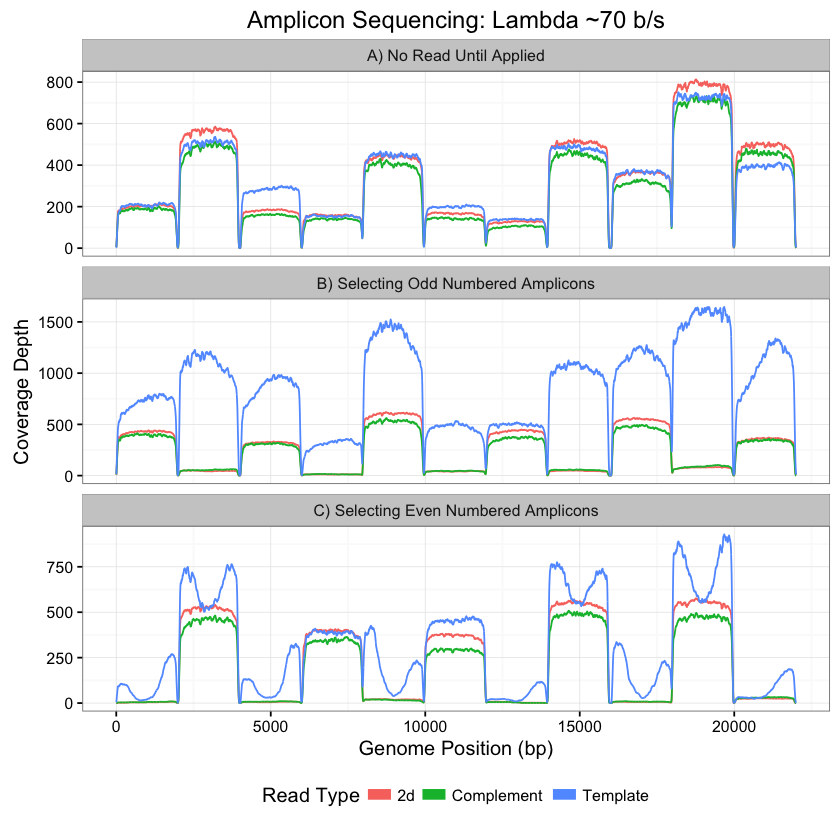

In [20]:
ggplot(data=Amplicons,aes(x=Position,y=Depth,color=Type)) + theme_bw()  + geom_line(size=0.5)+ labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "Amplicon Sequencing: Lambda ~70 b/s")   + xlim(0,22000) + facet_wrap(~Experiment,ncol=1,scales="free_y") + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))

#### Showing just 2D data.


Warning message:
: Removed 26452 rows containing missing values (geom_path).

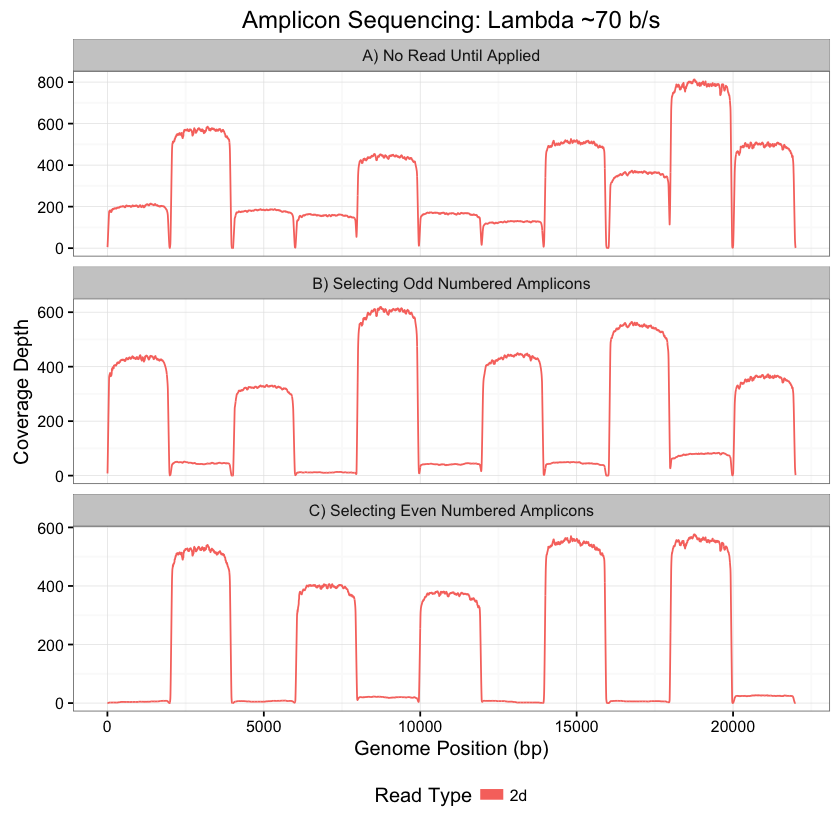

In [21]:
ggplot(data=Amplicons[Amplicons$Type=="2d",],aes(x=Position,y=Depth,color=Type)) + theme_bw()  + geom_line(size=0.5)+ labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "Amplicon Sequencing: Lambda ~70 b/s")   + xlim(0,22000) + facet_wrap(~Experiment,ncol=1,scales="free_y") + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))


In [41]:
dataT1 <-  read.csv('data/figs3/minion_1_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT2 <-  read.csv('data/figs3/minion_2_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT3 <-  read.csv('data/figs3/minion_3_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT4 <-  read.csv('data/figs3/minion_4_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT5 <-  read.csv('data/figs3/minion_5_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT6 <-  read.csv('data/figs3/minion_6_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT7 <-  read.csv('data/figs3/minion_7_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT8 <-  read.csv('data/figs3/minion_8_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT9 <-  read.csv('data/figs3/minion_9_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT10 <-  read.csv('data/figs3/minion_10_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataT11 <-  read.csv('data/figs3/minion_11_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Template.txt_in_50_windows.txt', header=FALSE, sep='\t')

dataC1 <-  read.csv('data/figs3/minion_1_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC2 <-  read.csv('data/figs3/minion_2_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC3 <-  read.csv('data/figs3/minion_3_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC4 <-  read.csv('data/figs3/minion_4_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC5 <-  read.csv('data/figs3/minion_5_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC6 <-  read.csv('data/figs3/minion_6_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC7 <-  read.csv('data/figs3/minion_7_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC8 <-  read.csv('data/figs3/minion_8_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC9 <-  read.csv('data/figs3/minion_9_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC10 <-  read.csv('data/figs3/minion_10_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')
dataC11 <-  read.csv('data/figs3/minion_11_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_Complement.txt_in_50_windows.txt', header=FALSE, sep='\t')

data1 <-  read.csv('data/figs3/minion_1_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data2 <-  read.csv('data/figs3/minion_2_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data3 <-  read.csv('data/figs3/minion_3_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data4 <-  read.csv('data/figs3/minion_4_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data5 <-  read.csv('data/figs3/minion_5_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data6 <-  read.csv('data/figs3/minion_6_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data7 <-  read.csv('data/figs3/minion_7_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data8 <-  read.csv('data/figs3/minion_8_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data9 <-  read.csv('data/figs3/minion_9_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data10 <-  read.csv('data/figs3/minion_10_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')
data11 <-  read.csv('data/figs3/minion_11_raw_llssbzms2p35x_20151005_readuntilnorm_RU24_lambdaPCR_2D.txt_in_50_windows.txt', header=FALSE, sep='\t')

data1<-cbind(data1,Amplicon=1)
  colnames(data1) <- c("Ref", "Position","Depth","Amplicon")
 data2<-cbind(data2,Amplicon=2)
  colnames(data2) <- c("Ref", "Position","Depth","Amplicon")
 data3<-cbind(data3,Amplicon=3)
  colnames(data3) <- c("Ref", "Position","Depth","Amplicon")
 data4<-cbind(data4,Amplicon=4)
  colnames(data4) <- c("Ref", "Position","Depth","Amplicon")
 data5<-cbind(data5,Amplicon=5)
  colnames(data5) <- c("Ref", "Position","Depth","Amplicon")
 data6<-cbind(data6,Amplicon=6)
  colnames(data6) <- c("Ref", "Position","Depth","Amplicon")
 data7<-cbind(data7,Amplicon=7)
  colnames(data7) <- c("Ref", "Position","Depth","Amplicon")
 data8<-cbind(data8,Amplicon=8)
  colnames(data8) <- c("Ref", "Position","Depth","Amplicon")
 data9<-cbind(data9,Amplicon=9)
  colnames(data9) <- c("Ref", "Position","Depth","Amplicon")
  data10<-cbind(data10,Amplicon=10)
   colnames(data10) <- c("Ref", "Position","Depth","Amplicon")
 data11<-cbind(data11,Amplicon=11)
colnames(data11) <- c("Ref", "Position","Depth","Amplicon")

dataC1<-cbind(dataC1,Amplicon=1)
 colnames(dataC1) <- c("Ref", "Position","Depth","Amplicon")
dataC2<-cbind(dataC2,Amplicon=2)
 colnames(dataC2) <- c("Ref", "Position","Depth","Amplicon")
dataC3<-cbind(dataC3,Amplicon=3)
 colnames(dataC3) <- c("Ref", "Position","Depth","Amplicon")
dataC4<-cbind(dataC4,Amplicon=4)
 colnames(dataC4) <- c("Ref", "Position","Depth","Amplicon")
dataC5<-cbind(dataC5,Amplicon=5)
 colnames(dataC5) <- c("Ref", "Position","Depth","Amplicon")
dataC6<-cbind(dataC6,Amplicon=6)
 colnames(dataC6) <- c("Ref", "Position","Depth","Amplicon")
dataC7<-cbind(dataC7,Amplicon=7)
 colnames(dataC7) <- c("Ref", "Position","Depth","Amplicon")
dataC8<-cbind(dataC8,Amplicon=8)
 colnames(dataC8) <- c("Ref", "Position","Depth","Amplicon")
dataC9<-cbind(dataC9,Amplicon=9)
 colnames(dataC9) <- c("Ref", "Position","Depth","Amplicon")
 dataC10<-cbind(dataC10,Amplicon=10)
  colnames(dataC10) <- c("Ref", "Position","Depth","Amplicon")
dataC11<-cbind(dataC11,Amplicon=11)
colnames(dataC11) <- c("Ref", "Position","Depth","Amplicon")

dataT1<-cbind(dataT1,Amplicon=1)
 colnames(dataT1) <- c("Ref", "Position","Depth","Amplicon")
dataT2<-cbind(dataT2,Amplicon=2)
 colnames(dataT2) <- c("Ref", "Position","Depth","Amplicon")
dataT3<-cbind(dataT3,Amplicon=3)
 colnames(dataT3) <- c("Ref", "Position","Depth","Amplicon")
dataT4<-cbind(dataT4,Amplicon=4)
 colnames(dataT4) <- c("Ref", "Position","Depth","Amplicon")
dataT5<-cbind(dataT5,Amplicon=5)
 colnames(dataT5) <- c("Ref", "Position","Depth","Amplicon")
dataT6<-cbind(dataT6,Amplicon=6)
 colnames(dataT6) <- c("Ref", "Position","Depth","Amplicon")
dataT7<-cbind(dataT7,Amplicon=7)
 colnames(dataT7) <- c("Ref", "Position","Depth","Amplicon")
dataT8<-cbind(dataT8,Amplicon=8)
 colnames(dataT8) <- c("Ref", "Position","Depth","Amplicon")
dataT9<-cbind(dataT9,Amplicon=9)
 colnames(dataT9) <- c("Ref", "Position","Depth","Amplicon")
 dataT10<-cbind(dataT10,Amplicon=10)
  colnames(dataT10) <- c("Ref", "Position","Depth","Amplicon")
dataT11<-cbind(dataT11,Amplicon=11)
colnames(dataT11) <- c("Ref", "Position","Depth","Amplicon")

amplicondata=rbind(data1,data2,data3,data4,data5,data6,data7,data8,data9,data10,data11)
amplicondataT=rbind(dataT1,dataT2,dataT3,dataT4,dataT5,dataT6,dataT7,dataT8,dataT9,dataT10,dataT11)
amplicondataC=rbind(dataC1,dataC2,dataC3,dataC4,dataC5,dataC6,dataC7,dataC8,dataC9,dataC10,dataC11)

amplicondata<-cbind(amplicondata,Type="2D")
amplicondataT<-cbind(amplicondataT,Type="Template")
amplicondataC<-cbind(amplicondataC,Type="Complement")
allamplicondata=rbind(amplicondata,amplicondataC,amplicondataT)

Warning message:
: Removed 79356 rows containing missing values (geom_path).

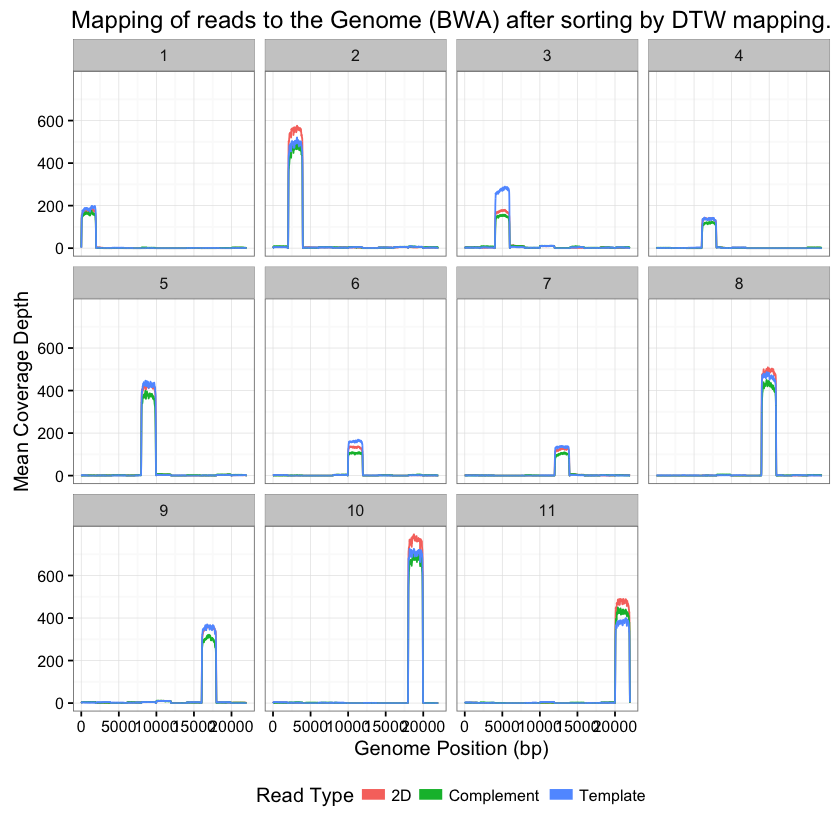

In [43]:
ggplot(data=allamplicondata,aes(x=Position,y=Depth,color=Type)) + geom_line()+ facet_wrap(~Amplicon) +theme_bw() + xlim(0,22000) + coord_trans(x="identity", y="identity")  + labs(title = "Mapping of reads to the Genome (BWA) after sorting by DTW mapping.",x = "Genome Position (bp)", y = "Mean Coverage Depth") + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))


Warning message:
: Removed 79356 rows containing missing values (geom_path).

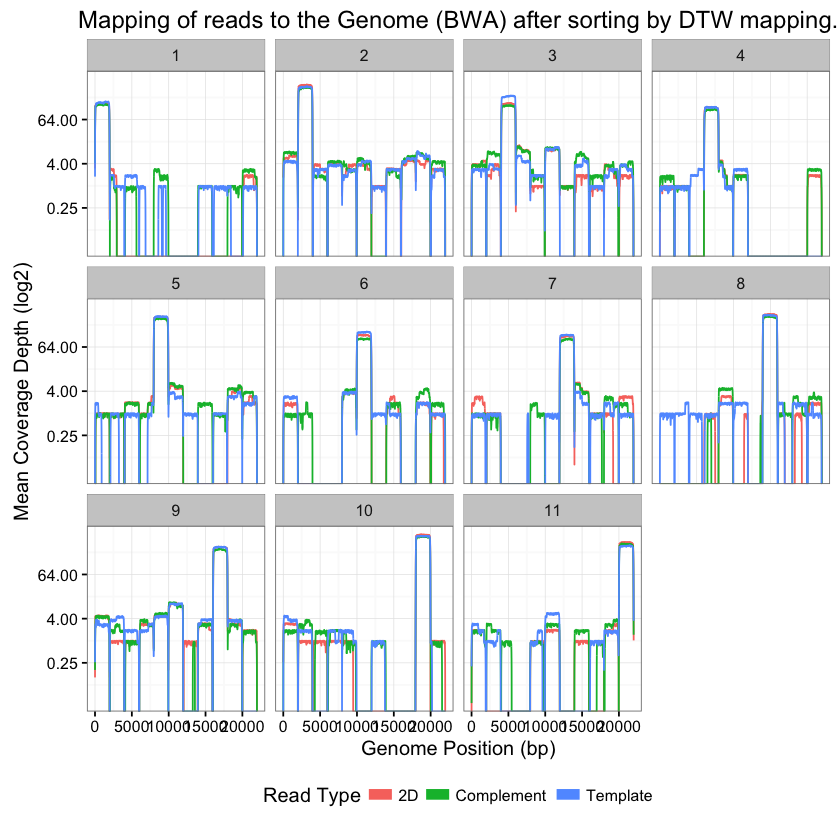

In [42]:
ggplot(data=allamplicondata,aes(x=Position,y=Depth,color=Type)) + geom_line()+ facet_wrap(~Amplicon) +theme_bw() + xlim(0,22000) + coord_trans(x="identity", y="identity")  + labs(title = "Mapping of reads to the Genome (BWA) after sorting by DTW mapping.",x = "Genome Position (bp)", y = "Mean Coverage Depth (log2)")+  scale_y_continuous(trans = "log2") + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))

### Figure 4 - Balancing Sequencing of Amplicons

These figures take as input bam files generated at 1 minute intervals from reads generated during the run.

In [22]:
CONT_Template = read.csv("data/fig4/NO_RU/NO_RU_Template.txt_in_50_windows.txt", header = FALSE,sep="\t")
CONT_Complement = read.csv("data/fig4/NO_RU/NO_RU_Complement.txt_in_50_windows.txt", header = FALSE,sep="\t")
CONT_2D = read.csv("data/fig4/NO_RU/NO_RU_2D.txt_in_50_windows.txt", header = FALSE,sep="\t")
BAL_Template = read.csv("data/fig4/200/200_Template.txt_in_50_windows.txt", header = FALSE,sep="\t")
BAL_Complement = read.csv("data/fig4/200/200_Complement.txt_in_50_windows.txt", header = FALSE,sep="\t")
BAL_2D = read.csv("data/fig4/200/200_2D.txt_in_50_windows.txt", header = FALSE,sep="\t")



In [23]:
CONT_Template <-cbind(CONT_Template,Type="Template")
CONT_Complement <-cbind(CONT_Complement,Type="Complement")
CONT_2D <-cbind(CONT_2D,Type="2d")
CONT<-rbind(CONT_2D,CONT_Complement,CONT_Template)
colnames(CONT) <- c("Ref", "Position","Depth","Type")
CONT<-cbind(CONT,Experiment="Library Control")

BAL_Template <-cbind(BAL_Template,Type="Template")
BAL_Complement <-cbind(BAL_Complement,Type="Complement")
BAL_2D <-cbind(BAL_2D,Type="2d")
BAL<-rbind(BAL_2D,BAL_Complement,BAL_Template)
colnames(BAL) <- c("Ref", "Position","Depth","Type")
BAL<-cbind(BAL,Experiment="Normalised")

AmpliconsNormalised <-rbind(CONT,BAL)

Warning message:
: Removed 79356 rows containing missing values (geom_path).

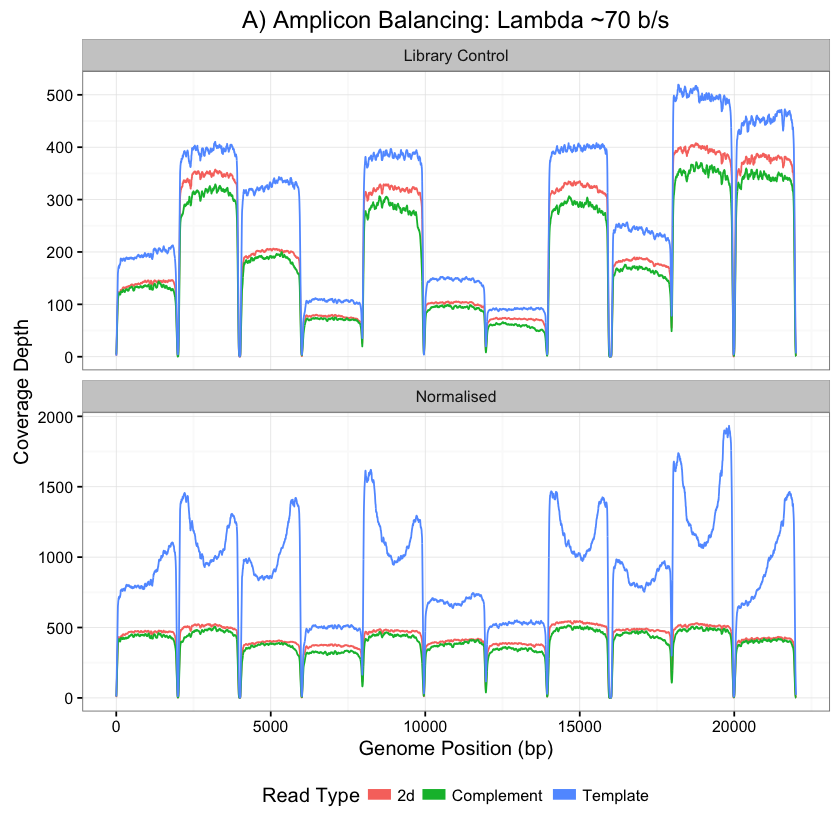

In [26]:
ggplot(data=AmpliconsNormalised,aes(x=Position,y=Depth,color=Type)) + theme_bw()  + geom_line(size=0.5)+ labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "A) Amplicon Balancing: Lambda ~70 b/s")   + xlim(0,22000) + facet_wrap(~Experiment,ncol=1,scales="free_y") + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))

In [27]:
mergedatatemplate <- read.csv('data/fig4/template/minion_PLSP57501_default_sample_idmerge.txt', header=FALSE,sep='\t')
mergedatatemplatenorm <- read.csv('data/fig4/template/minion_PLSP57501_lambda_200xRUmerge.txt', header=FALSE,sep='\t')
mergedata2d <- read.csv('data/fig4/minion_PLSP57501_default_sample_idmerge.txt', header = FALSE ,sep='\t')
mergedata2dnorm <- read.csv('data/fig4/minion_PLSP57501_lambda_200xRUmerge.txt', header = FALSE, sep='\t')

mergedatacomplement <- read.csv('data/fig4/complement/minion_PLSP57501_default_sample_idmerge.txt', header=FALSE,sep='\t')
mergedatacomplementnorm <- read.csv('data/fig4/complement/minion_PLSP57501_lambda_200xRUmerge.txt', header=FALSE,sep='\t')


In [28]:
amplicontemplatenorm1 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=52 & mergedatatemplatenorm$V2<=1980),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=1, Treatment="Read Until")
amplicontemplatenorm2 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=2065 & mergedatatemplatenorm$V2<=3965),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=2, Treatment="Read Until")
amplicontemplatenorm3 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=4070 & mergedatatemplatenorm$V2<=5989),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=3, Treatment="Read Until")
amplicontemplatenorm4 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=6059 & mergedatatemplatenorm$V2<=7981),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=4, Treatment="Read Until")
amplicontemplatenorm5 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=8012 & mergedatatemplatenorm$V2<=9947),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=5, Treatment="Read Until")
amplicontemplatenorm6 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=10008 & mergedatatemplatenorm$V2<=11963),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=6, Treatment="Read Until")
amplicontemplatenorm7 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=12006 & mergedatatemplatenorm$V2<=13941),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=7, Treatment="Read Until")
amplicontemplatenorm8 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=14011 & mergedatatemplatenorm$V2<=15945),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=8, Treatment="Read Until")
amplicontemplatenorm9 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=16076 & mergedatatemplatenorm$V2<=17987),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=9, Treatment="Read Until")
amplicontemplatenorm10 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=18022 & mergedatatemplatenorm$V2<=19972),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=10, Treatment="Read Until")
amplicontemplatenorm11 <- ddply(mergedatatemplatenorm[(mergedatatemplatenorm$V2>=20053 & mergedatatemplatenorm$V2<=21979),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=11, Treatment="Read Until")


amplicontemplate1 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=52 & mergedatatemplate$V2<=1980),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=1, Treatment="Normal")
amplicontemplate2 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=2065 & mergedatatemplate$V2<=3965),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=2, Treatment="Normal")
amplicontemplate3 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=4070 & mergedatatemplate$V2<=5989),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=3, Treatment="Normal")
amplicontemplate4 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=6059 & mergedatatemplate$V2<=7981),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=4, Treatment="Normal")
amplicontemplate5 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=8012 & mergedatatemplate$V2<=9947),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=5, Treatment="Normal")
amplicontemplate6 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=10008 & mergedatatemplate$V2<=11963),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=6, Treatment="Normal")
amplicontemplate7 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=12006 & mergedatatemplate$V2<=13941),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=7, Treatment="Normal")
amplicontemplate8 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=14011 & mergedatatemplate$V2<=15945),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=8, Treatment="Normal")
amplicontemplate9 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=16076 & mergedatatemplate$V2<=17987),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=9, Treatment="Normal")
amplicontemplate10 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=18022 & mergedatatemplate$V2<=19972),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=10, Treatment="Normal")
amplicontemplate11 <- ddply(mergedatatemplate[(mergedatatemplate$V2>=20053 & mergedatatemplate$V2<=21979),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=11, Treatment="Normal")

ampliconcomplementnorm1 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=52 & mergedatacomplementnorm$V2<=1980),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=1, Treatment="Read Until")
ampliconcomplementnorm2 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=2065 & mergedatacomplementnorm$V2<=3965),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=2, Treatment="Read Until")
ampliconcomplementnorm3 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=4070 & mergedatacomplementnorm$V2<=5989),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=3, Treatment="Read Until")
ampliconcomplementnorm4 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=6059 & mergedatacomplementnorm$V2<=7981),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=4, Treatment="Read Until")
ampliconcomplementnorm5 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=8012 & mergedatacomplementnorm$V2<=9947),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=5, Treatment="Read Until")
ampliconcomplementnorm6 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=10008 & mergedatacomplementnorm$V2<=11963),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=6, Treatment="Read Until")
ampliconcomplementnorm7 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=12006 & mergedatacomplementnorm$V2<=13941),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=7, Treatment="Read Until")
ampliconcomplementnorm8 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=14011 & mergedatacomplementnorm$V2<=15945),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=8, Treatment="Read Until")
ampliconcomplementnorm9 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=16076 & mergedatacomplementnorm$V2<=17987),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=9, Treatment="Read Until")
ampliconcomplementnorm10 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=18022 & mergedatacomplementnorm$V2<=19972),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=10, Treatment="Read Until")
ampliconcomplementnorm11 <- ddply(mergedatacomplementnorm[(mergedatacomplementnorm$V2>=20053 & mergedatacomplementnorm$V2<=21979),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=11, Treatment="Read Until")


ampliconcomplement1 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=52 & mergedatacomplement$V2<=1980),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=1, Treatment="Normal")
ampliconcomplement2 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=2065 & mergedatacomplement$V2<=3965),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=2, Treatment="Normal")
ampliconcomplement3 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=4070 & mergedatacomplement$V2<=5989),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=3, Treatment="Normal")
ampliconcomplement4 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=6059 & mergedatacomplement$V2<=7981),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=4, Treatment="Normal")
ampliconcomplement5 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=8012 & mergedatacomplement$V2<=9947),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=5, Treatment="Normal")
ampliconcomplement6 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=10008 & mergedatacomplement$V2<=11963),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=6, Treatment="Normal")
ampliconcomplement7 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=12006 & mergedatacomplement$V2<=13941),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=7, Treatment="Normal")
ampliconcomplement8 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=14011 & mergedatacomplement$V2<=15945),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=8, Treatment="Normal")
ampliconcomplement9 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=16076 & mergedatacomplement$V2<=17987),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=9, Treatment="Normal")
ampliconcomplement10 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=18022 & mergedatacomplement$V2<=19972),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=10, Treatment="Normal")
ampliconcomplement11 <- ddply(mergedatacomplement[(mergedatacomplement$V2>=20053 & mergedatacomplement$V2<=21979),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=11, Treatment="Normal")

amplicon2dnorm1 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=52 & mergedata2dnorm$V2<=1980),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=1, Treatment="Read Until")
amplicon2dnorm2 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=2065 & mergedata2dnorm$V2<=3965),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=2, Treatment="Read Until")
amplicon2dnorm3 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=4070 & mergedata2dnorm$V2<=5989),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=3, Treatment="Read Until")
amplicon2dnorm4 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=6059 & mergedata2dnorm$V2<=7981),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=4, Treatment="Read Until")
amplicon2dnorm5 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=8012 & mergedata2dnorm$V2<=9947),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=5, Treatment="Read Until")
amplicon2dnorm6 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=10008 & mergedata2dnorm$V2<=11963),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=6, Treatment="Read Until")
amplicon2dnorm7 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=12006 & mergedata2dnorm$V2<=13941),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=7, Treatment="Read Until")
amplicon2dnorm8 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=14011 & mergedata2dnorm$V2<=15945),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=8, Treatment="Read Until")
amplicon2dnorm9 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=16076 & mergedata2dnorm$V2<=17987),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=9, Treatment="Read Until")
amplicon2dnorm10 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=18022 & mergedata2dnorm$V2<=19972),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=10, Treatment="Read Until")
amplicon2dnorm11 <- ddply(mergedata2dnorm[(mergedata2dnorm$V2>=20053 & mergedata2dnorm$V2<=21979),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=11, Treatment="Read Until")


amplicon2d1 <- ddply(mergedata2d[(mergedata2d$V2>=52 & mergedata2d$V2<=1980),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=1, Treatment="Normal")
amplicon2d2 <- ddply(mergedata2d[(mergedata2d$V2>=2065 & mergedata2d$V2<=3965),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=2, Treatment="Normal")
amplicon2d3 <- ddply(mergedata2d[(mergedata2d$V2>=4070 & mergedata2d$V2<=5989),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=3, Treatment="Normal")
amplicon2d4 <- ddply(mergedata2d[(mergedata2d$V2>=6059 & mergedata2d$V2<=7981),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=4, Treatment="Normal")
amplicon2d5 <- ddply(mergedata2d[(mergedata2d$V2>=8012 & mergedata2d$V2<=9947),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=5, Treatment="Normal")
amplicon2d6 <- ddply(mergedata2d[(mergedata2d$V2>=10008 & mergedata2d$V2<=11963),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=6, Treatment="Normal")
amplicon2d7 <- ddply(mergedata2d[(mergedata2d$V2>=12006 & mergedata2d$V2<=13941),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=7, Treatment="Normal")
amplicon2d8 <- ddply(mergedata2d[(mergedata2d$V2>=14011 & mergedata2d$V2<=15945),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=8, Treatment="Normal")
amplicon2d9 <- ddply(mergedata2d[(mergedata2d$V2>=16076 & mergedata2d$V2<=17987),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=9, Treatment="Normal")
amplicon2d10 <- ddply(mergedata2d[(mergedata2d$V2>=18022 & mergedata2d$V2<=19972),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=10, Treatment="Normal")
amplicon2d11 <- ddply(mergedata2d[(mergedata2d$V2>=20053 & mergedata2d$V2<=21979),], .(V4),summarize, MeanCoverage=mean(V3),MaxCoverage=max(V3),amplicon=11, Treatment="Normal")



ampliconstemplate <- rbind(amplicontemplate1,amplicontemplate2,amplicontemplate3,amplicontemplate4,amplicontemplate5,amplicontemplate6,amplicontemplate7,amplicontemplate8,amplicontemplate9,amplicontemplate10,amplicontemplate11,amplicontemplatenorm1,amplicontemplatenorm2,amplicontemplatenorm3,amplicontemplatenorm4,amplicontemplatenorm5,amplicontemplatenorm6,amplicontemplatenorm7,amplicontemplatenorm8,amplicontemplatenorm9,amplicontemplatenorm10,amplicontemplatenorm11)
ampliconscomplement <- rbind(ampliconcomplement1,ampliconcomplement2,ampliconcomplement3,ampliconcomplement4,ampliconcomplement5,ampliconcomplement6,ampliconcomplement7,ampliconcomplement8,ampliconcomplement9,ampliconcomplement10,ampliconcomplement11,ampliconcomplementnorm1,ampliconcomplementnorm2,ampliconcomplementnorm3,ampliconcomplementnorm4,ampliconcomplementnorm5,ampliconcomplementnorm6,ampliconcomplementnorm7,ampliconcomplementnorm8,ampliconcomplementnorm9,ampliconcomplementnorm10,ampliconcomplementnorm11)
amplicons2d <- rbind(amplicon2d1,amplicon2d2,amplicon2d3,amplicon2d4,amplicon2d5,amplicon2d6,amplicon2d7,amplicon2d8,amplicon2d9,amplicon2d10,amplicon2d11,amplicon2dnorm1,amplicon2dnorm2,amplicon2dnorm3,amplicon2dnorm4,amplicon2dnorm5,amplicon2dnorm6,amplicon2dnorm7,amplicon2dnorm8,amplicon2dnorm9,amplicon2dnorm10,amplicon2dnorm11)

ampliconstemplate <- cbind(ampliconstemplate, Type="Template")
ampliconscomplement <- cbind(ampliconscomplement, Type="Complement")
amplicons2d <- cbind(amplicons2d, Type="2d")
ampliconstype <- rbind(amplicons2d,ampliconstemplate,ampliconscomplement)

In [31]:
MaxVals <- data.frame()


for(i in 1:11)
{
    ##Max Coverage
    selamp=i
    nam <- paste("P", i, sep = "")
    nam2 <- paste("M", i , sep="")
    #assign(nam, ggplot(data=ampliconstype[ampliconstype$amplicon==selamp,], aes(x=V4, y=MaxCoverage, group=interaction(amplicon,Treatment,Type), color=Treatment, shape=Type)) + geom_point()  + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,],method="lm",fullrange=TRUE) + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="Template" & ampliconstype$amplicon==selamp,],method="lm",fullrange=TRUE) + labs(title = paste("Amplicon",strwrap(selamp)), x = "Coverage Depth In 1 Minute Increments", y = "Max Coverage"))
    #assign(nam,  ggplot(data=ampliconstype[ampliconstype$amplicon==selamp,], aes(x=V4, y=MaxCoverage, group=interaction(amplicon,Treatment,Type), color=Treatment, shape=Type)) + geom_point()  + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp &ampliconstype$V4<=14,],method="lm",fullrange=TRUE) +labs(title = paste("amplicon",strwrap(selamp)), x = "", y = "") + theme_minimal()  + theme(legend.position="none"))
    assign(nam,  ggplot(data=ampliconstype[ampliconstype$amplicon==selamp & ampliconstype$Type=="2d",], aes(x=V4, y=MaxCoverage, group=interaction(amplicon,Treatment,Type), color=Treatment, shape=Type)) + geom_point()  + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp &ampliconstype$V4<=14,],method="lm",fullrange=TRUE) +labs(title = paste("Amplicon",strwrap(selamp)), x = "", y = "") + theme_minimal()  + theme(legend.position="none"))
    assign(nam2,  ggplot(data=ampliconstype[ampliconstype$amplicon==selamp & ampliconstype$Type=="2d",], aes(x=V4, y=MeanCoverage, group=interaction(amplicon,Treatment,Type), color=Treatment, shape=Type)) + geom_point()  + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp &ampliconstype$V4<=14,],method="lm",fullrange=TRUE) +labs(title = paste("Amplicon",strwrap(selamp)), x = "", y = "") + theme_minimal()  + theme(legend.position="none"))
    ObservedDepth = tail(ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]$MaxCoverage,1)
    ExpectedDepthMaxRU = summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[2] * 48 + summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[1]
    ExpectedDepthMeanRU = summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[2] * 48 + summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[1]
    ExpectedDepthMaxnoRU = summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[2] * 48 + summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[1]
    ExpectedDepthMeannoRU = summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[2] * 48 + summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[1]

    ExpectedDepthMaxRU105 = summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[2] * 105 + summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[1]
    ExpectedDepthMeanRU105 = summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[2] * 105 + summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[1]
    ExpectedDepthMaxnoRU105 = summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[2] * 105 + summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[1]
    ExpectedDepthMeannoRU105 = summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[2] * 105 + summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[1]



    Time2MaxRU = (tail(ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]$MaxCoverage,1)-summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[1])/summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[2] # Time to reach Max Coverage
    Time2MaxnoRU = (tail(ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]$MaxCoverage,1)-summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[1])/summary(lm(MaxCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[2] # Time to reach Max Coverage based on no read until
    Time2MeanRU = (tail(ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]$MeanCoverage,1)-summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[1])/summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp & ampliconstype$V4<=14,]) )$coefficients[2] # Time to reach Mean Coverage
    Time2MeannoRU = (tail(ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]$MeanCoverage,1)-summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[1])/summary(lm(MeanCoverage ~ V4, data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$Type=="2d" & ampliconstype$amplicon==selamp,]) )$coefficients[2] # Time to reach Max Coverage based on no read until
    #print(paste(i,",",ObservedDepth,",",ExpectedDepthMaxRU,",",ExpectedDepthMeanRU,",",ExpectedDepthMaxnoRU,",",ExpectedDepthMeannoRU,",",Time2MaxRU, "'",Time2MaxnoRU, ",",Time2MeanRU,",",Time2MeannoRU))
    MaxVals <- rbind(MaxVals,c(i,ObservedDepth,ExpectedDepthMaxRU,ExpectedDepthMeanRU,ExpectedDepthMaxnoRU,ExpectedDepthMeannoRU,ExpectedDepthMaxRU105,ExpectedDepthMeanRU105,ExpectedDepthMaxnoRU105,ExpectedDepthMeannoRU105,Time2MaxRU,Time2MaxnoRU,Time2MeanRU,Time2MeannoRU))
}
colnames(MaxVals) <- c("i","ObservedDepth","ExpectedDepthMaxRU","ExpectedDepthMeanRU","ExpectedDepthMaxnoRU","ExpectedDepthMeannoRU","ExpectedDepthMaxRU105","ExpectedDepthMeanRU105","ExpectedDepthMaxnoRU105","ExpectedDepthMeannoRU105","Time2MaxRU","Time2MaxnoRU","Time2MeanRU","Time2MeannoRU")


In [33]:
Prediction=subset(MaxVals, select=c(i,ObservedDepth))
Prediction<-cbind(Prediction,Type="Observed Depth With Read Until (48 Minutes)")
colnames(Prediction)<-c("Amplicon","Depth","Type")
TempPrediction=subset(MaxVals,select=c(i,ExpectedDepthMeanRU))
TempPrediction<-cbind(TempPrediction,Type="Expected Depth No Read Until (48 Minutes)")
colnames(TempPrediction)<-c("Amplicon","Depth","Type")
Prediction<-rbind(Prediction,TempPrediction)
TempPrediction=subset(MaxVals,select=c(i,ExpectedDepthMeanRU105))
TempPrediction<-cbind(TempPrediction,Type="Projected Depth No Read Until (105 Minutes)")
colnames(TempPrediction)<-c("Amplicon","Depth","Type")
Prediction<-rbind(Prediction,TempPrediction)
Prediction$Type <- factor(Prediction$Type, levels = c("Observed Depth With Read Until (48 Minutes)","Expected Depth No Read Until (48 Minutes)","Projected Depth No Read Until (105 Minutes)"))

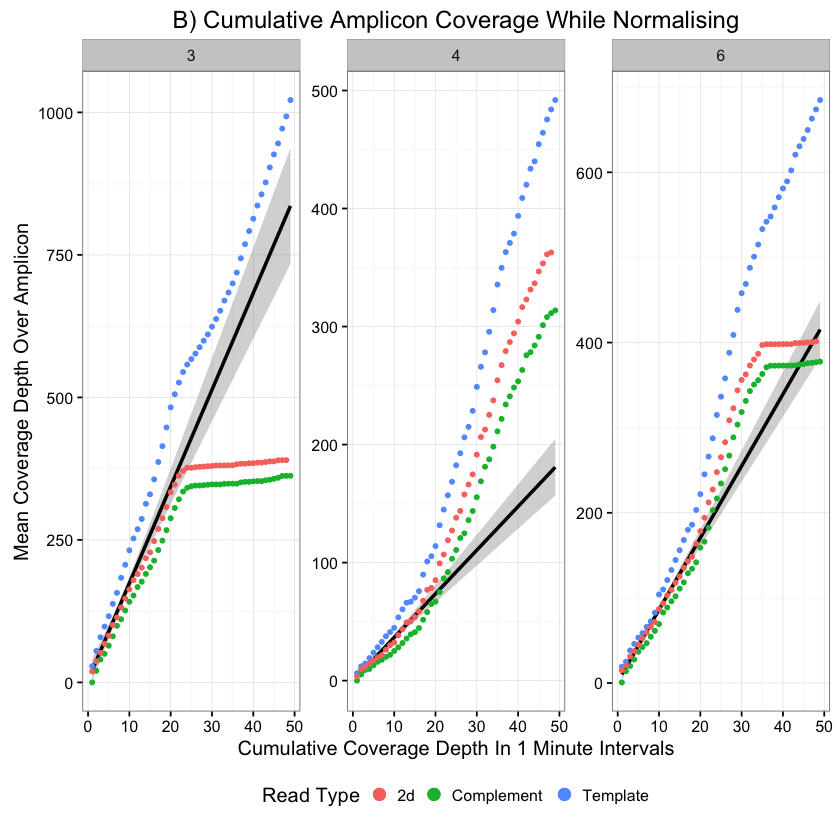

In [34]:
ggplot(data=ampliconstype[ampliconstype$Treatment=="Read Until"&ampliconstype$amplicon %in% c(3,4,6),], aes(x=V4,y=MeanCoverage,color=Type)) + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$V4<=15&ampliconstype$amplicon %in% c(3,4,6),],method="lm",fullrange=TRUE, color="black") + geom_point(data=ampliconstype[ampliconstype$Type=="Template" & ampliconstype$Treatment=="Read Until"&ampliconstype$amplicon %in% c(3,4,6),],size = 1) + geom_point(data=ampliconstype[ampliconstype$Type=="Complement"&ampliconstype$Treatment=="Read Until"&ampliconstype$amplicon %in% c(3,4,6),],size = 1) + geom_point(data=ampliconstype[ampliconstype$Type=="2d"&ampliconstype$Treatment=="Read Until"&ampliconstype$amplicon %in% c(3,4,6),],size = 1) + facet_wrap(~amplicon,scales="free_y") + theme_bw() + labs(title = "B) Cumulative Amplicon Coverage While Normalising",x = "Cumulative Coverage Depth In 1 Minute Intervals", y = "Mean Coverage Depth Over Amplicon")  + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))

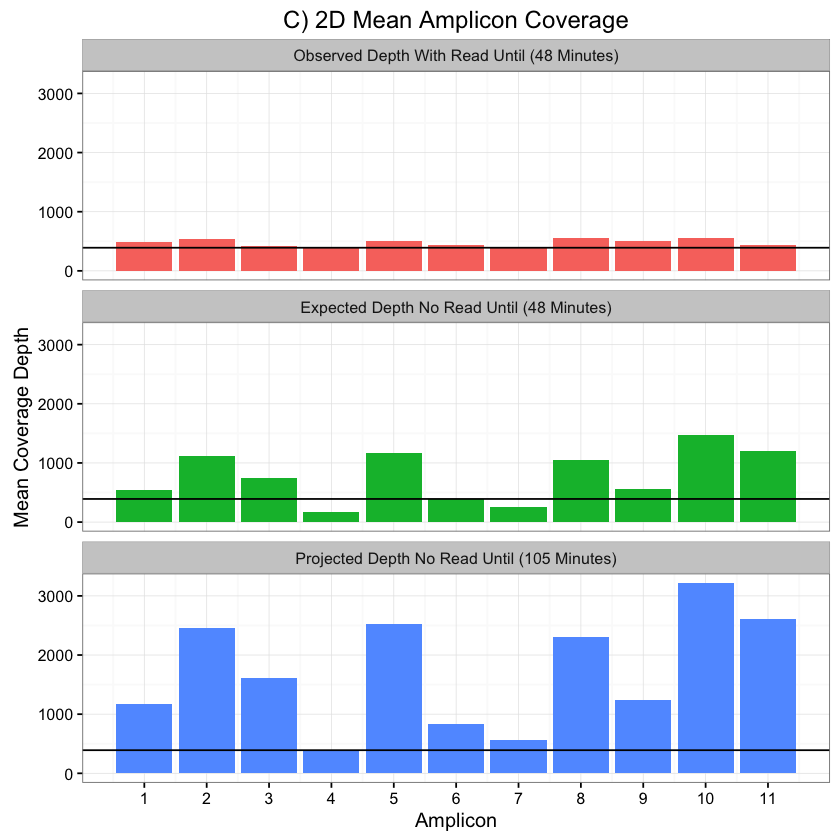

In [35]:
ggplot(data=Prediction,aes(x=Amplicon,y=Depth,fill=Type))+geom_bar(stat="identity",position=position_dodge())+theme_bw()+facet_wrap(~Type,ncol=1,scales="fixed")+ labs(title = "C) 2D Mean Amplicon Coverage",x = "Amplicon", y = "Mean Coverage Depth")  +theme(legend.position="none") +scale_x_continuous(breaks = round(seq(min(Prediction$Amplicon), max(Prediction$Amplicon), by = 1),1)) + geom_hline(yintercept=391)

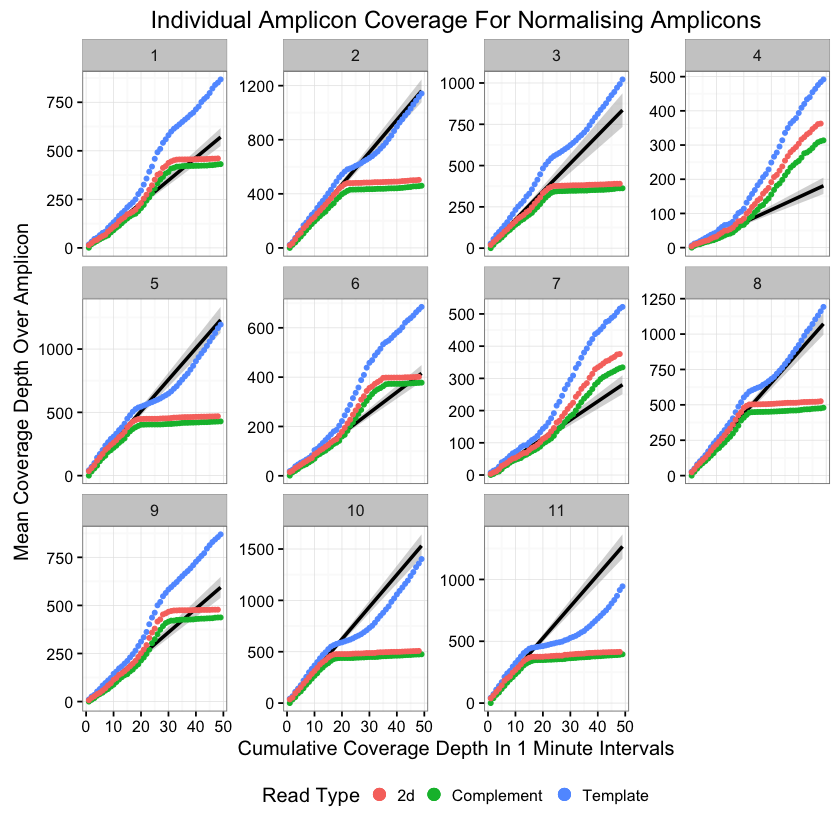

In [46]:
ggplot(data=ampliconstype[ampliconstype$Treatment=="Read Until",], aes(x=V4,y=MeanCoverage,color=Type)) + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$V4<=15,],method="lm",fullrange=TRUE, color="black") + geom_point(data=ampliconstype[ampliconstype$Type=="Template" & ampliconstype$Treatment=="Read Until",],size = 1) + geom_point(data=ampliconstype[ampliconstype$Type=="Complement"&ampliconstype$Treatment=="Read Until",],size = 1) + geom_point(data=ampliconstype[ampliconstype$Type=="2d"&ampliconstype$Treatment=="Read Until",],size = 1) + facet_wrap(~amplicon,scales="free_y") + theme_bw() + labs(title = "Individual Amplicon Coverage For Normalising Amplicons",x = "Cumulative Coverage Depth In 1 Minute Intervals", y = "Mean Coverage Depth Over Amplicon")  + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))

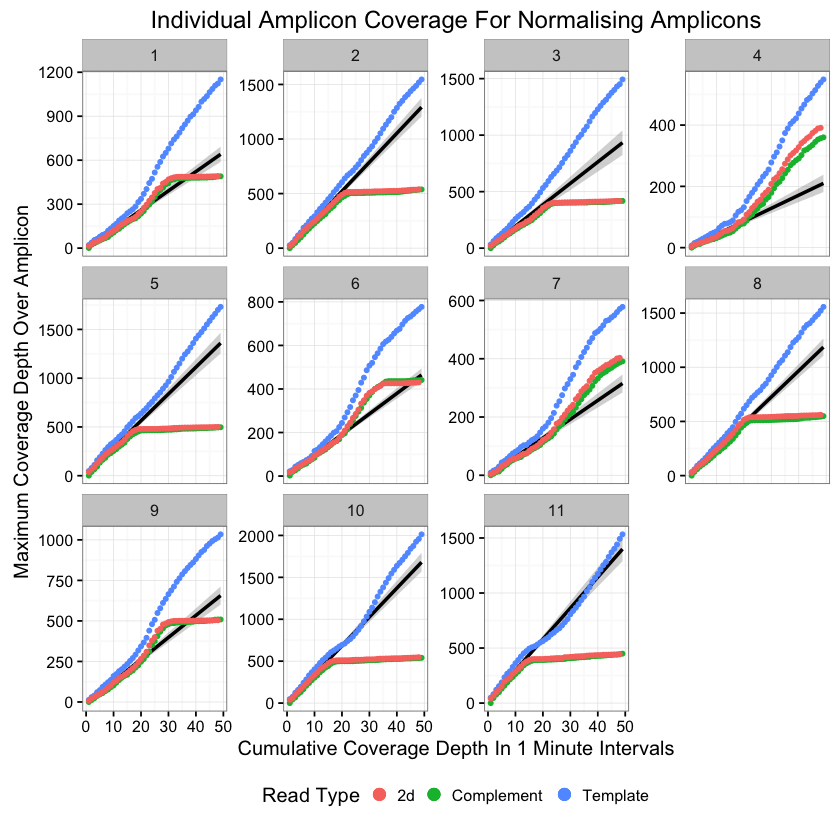

In [44]:
ggplot(data=ampliconstype[ampliconstype$Treatment=="Read Until",], aes(x=V4,y=MaxCoverage,color=Type)) + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Read Until" & ampliconstype$V4<=15,],method="lm",fullrange=TRUE, color="black") + geom_point(data=ampliconstype[ampliconstype$Type=="Template" & ampliconstype$Treatment=="Read Until",],size = 1) + geom_point(data=ampliconstype[ampliconstype$Type=="Complement"&ampliconstype$Treatment=="Read Until",],size = 1) + geom_point(data=ampliconstype[ampliconstype$Type=="2d"&ampliconstype$Treatment=="Read Until",],size = 1) + facet_wrap(~amplicon,scales="free_y") + theme_bw() + labs(title = "Individual Amplicon Coverage For Normalising Amplicons",x = "Cumulative Coverage Depth In 1 Minute Intervals", y = "Maximum Coverage Depth Over Amplicon")  + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))

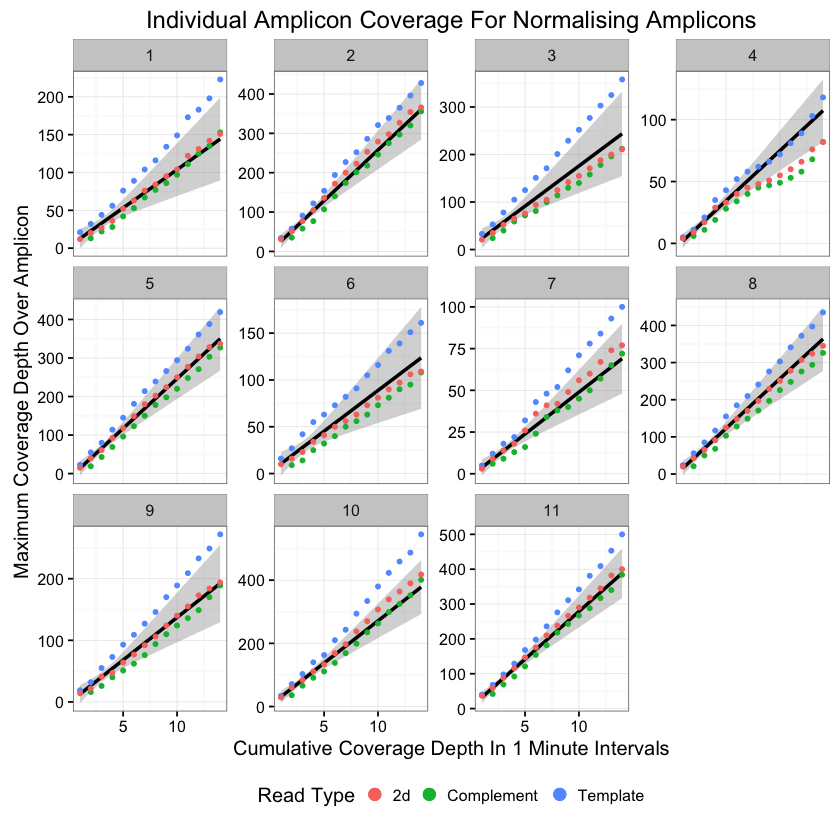

In [45]:
ggplot(data=ampliconstype[ampliconstype$Treatment=="Normal",], aes(x=V4,y=MaxCoverage,color=Type)) + stat_smooth(data=ampliconstype[ampliconstype$Treatment=="Normal" & ampliconstype$V4<=5,],method="lm",fullrange=TRUE, color="black") + geom_point(data=ampliconstype[ampliconstype$Type=="Template"&ampliconstype$Treatment=="Normal",],size = 1) + geom_point(data=ampliconstype[ampliconstype$Type=="Complement"&ampliconstype$Treatment=="Normal",],size = 1) + geom_point(data=ampliconstype[ampliconstype$Type=="2d"&ampliconstype$Treatment=="Normal",],size = 1) + facet_wrap(~amplicon,scales="free_y") + theme_bw() + labs(title = "Individual Amplicon Coverage For Normalising Amplicons",x = "Cumulative Coverage Depth In 1 Minute Intervals", y = "Maximum Coverage Depth Over Amplicon")  + scale_colour_discrete(name  = "Read Type") + theme(legend.position="bottom" , legend.key = element_blank() ) + guides(colour = guide_legend(override.aes = list(size=3)))